### Musical Recurrence Plots
    - Recurrence plots are often used to analyze patterns of repition, cycles, and trend in a time series. 
    - They have been applied to signal processing and analysis of physical systems as well.
  
  
    The canonical structures the images represent (for pure states) are:
    
    
 <img src="https://github.com/swsanalytics/media/blob/master/typology.png">    


"
* Homogeneous RPs are typical of stationary and autonomous systems in which relaxation times are short in comparison with the time spanned by the RP. An example of such an RP is that of a random time series.
Oscillating systems have RPs with diagonal oriented, periodic recurrent structures (diagonal lines, checkerboard structures). For quasi-periodic systems, the distances between the diagonal lines are different. However, even for those oscillating systems whose oscillations are not easily recognizable, the RPs can be used in order to find their oscillations.

* The drift is caused by systems with slowly varying parameters. Such slow (adiabatic) change brightens the RP's upper-left and lower-right corners.

* Abrupt changes in the dynamics as well as extreme events cause white areas or bands in the RP. RPs offer an easy possibility to find and to assess extreme and rare events by using the frequency of their recurrences.
"

<b><i>Source: http://www.recurrence-plot.tk/glance.php</b></i>

In this notebook, recurrence plots will be used in a musicology analysis of recordings of classical music labeled by composer, primarily from the FFA free music dataset. The scope of the analysis will be to determine if recurrence patterns can predict the composer; feature attribution methods will be applied to isolate and analyze important regions of the recurrence plots that contribute to a prediction. 

An autoencoder model will be applied to the recurrence plot data to analyze the latent space of the images. 

<b> This notebook is a work in progress
    To do: Align music records to the audio output
           - How will the recurrence plot images need to be standardized?
             * e.g., a 30 minute bartok piece vs. a 6 minute vivaldi piece?
    

In [3]:
import os
os.chdir("/home/spenser/Documents/music_AI")

#Librosa is the primary audio analysis package we'll be using 
import librosa
from librosa.display import waveplot

### Recurrence Plots 
import numpy as np
from scipy.spatial.distance import pdist
from scipy.spatial.distance import squareform
from hurst import compute_Hc, random_walk

import gc

import matplotlib.pyplot as plt
### Testing stationarity 
## By itself this is an apparently stationary series. However, it does exhibit seasonality.
import pandas as pd


### C Major Scale, Audio Import
    - Harmonic and Percussive Decomposition

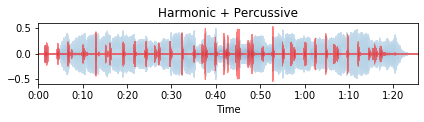

In [16]:
import matplotlib.pyplot as plt

yc, src = librosa.load('CMajor.mp3')
y_harmc, y_percc = librosa.effects.hpss(yc)
plt.subplot(3, 1, 3)
waveplot(y_harmc, sr=src, alpha=0.25)
waveplot(y_percc, sr=src, color='r', alpha=0.5)
plt.title('Harmonic + Percussive')
plt.tight_layout()
plt.show()

### Baseline Image : Spectogram of C Major Scale - Chromatic 

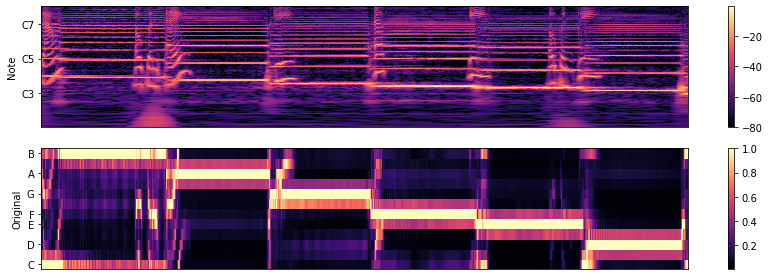

In [42]:
chroma_orig = librosa.feature.chroma_cqt(y=yc, sr=src)

# For display purposes, let's zoom in on a 15-second chunk from the middle of the song
idx = tuple([slice(None), slice(*list(librosa.time_to_frames([45, 60])))])

# And for comparison, we'll show the CQT matrix as well.
C = np.abs(librosa.cqt(y=yc, sr=src, bins_per_octave=12*3, n_bins=7*12*3))


plt.figure(figsize=(12, 4))
plt.subplot(2, 1, 1)
librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max)[idx],
                         y_axis='cqt_note', bins_per_octave=12*3)
plt.colorbar()
plt.subplot(2, 1, 2)
librosa.display.specshow(chroma_orig[idx], y_axis='chroma')
plt.colorbar()
plt.ylabel('Original')
plt.tight_layout()

/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:


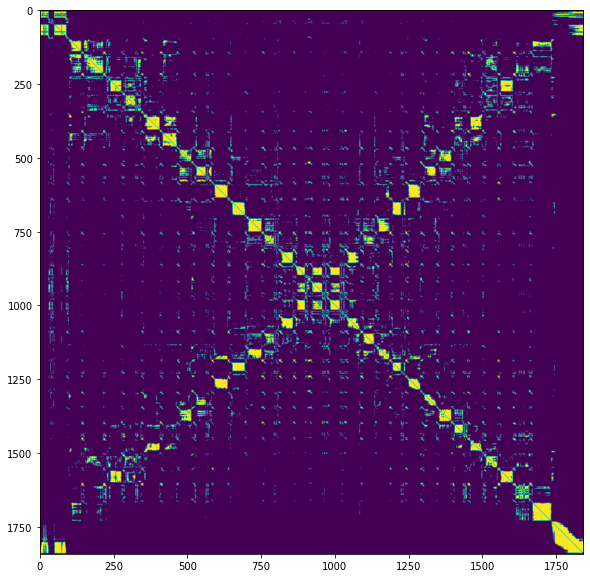

In [17]:
hop_length = 1024
mfcc = librosa.feature.mfcc(y=yc, sr=src, hop_length=hop_length)
R = librosa.segment.recurrence_matrix(mfcc)

plt.figure(figsize = (10,10))
plt.imshow(R, interpolation='bilinear')

### Vivaldi -La Follia 

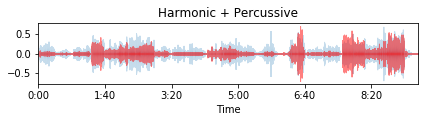

In [6]:
import matplotlib.pyplot as plt

yv, srv = librosa.load('Vivaldi La Follia.mp3')
y_harmv, y_percv = librosa.effects.hpss(yv)
plt.subplot(3, 1, 3)
waveplot(y_harmv, sr=srv, alpha=0.25)
waveplot(y_percv, sr=srv, color='r', alpha=0.5)
plt.title('Harmonic + Percussive')
plt.tight_layout()
plt.show()

"Similar to the results from our fast-Fourier
transforms, classical tracks feature long horizontal lines in the spectrograms representing
18 lasting and steady notes. Metal tracks feature heavy activity across the frequency spectrum
so that the entire mel-spectrogram appears bright. Disco tracks feature long vertical lines
with equal intervals on the spectrograms because of their steady beats. Hiphop tracks also
feature vertical lines across the entire frequency spectrum, but the intervals are not uniform
across the track, most likely due to the fact that hiphop songs change up their rhythm every
once in a while."

Yang, Jingqing.
https://pdfs.semanticscholar.org/66f9/d365b3dab74f6fde890dd7abba05cc728bf1.pdf

### Recurrence Plot - MFCC (Vivaldi La Follia )

/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:


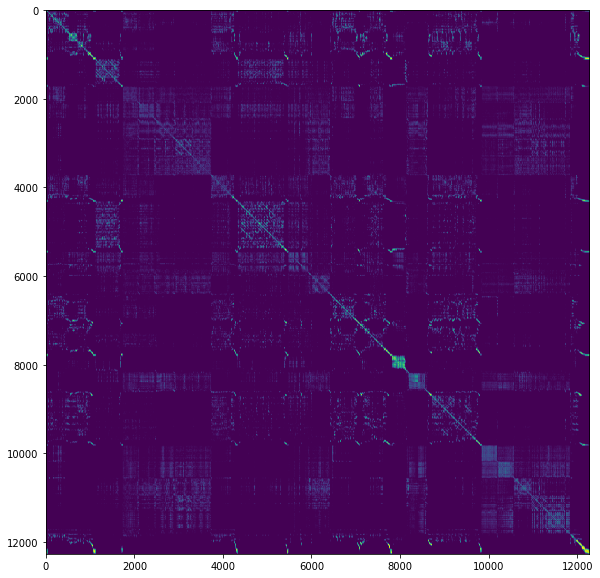

In [11]:
hop_length = 1024
mfcc = librosa.feature.mfcc(y=yv, sr=srv, hop_length=hop_length)
R = librosa.segment.recurrence_matrix(mfcc)

plt.figure(figsize = (10,10))
plt.imshow(R, interpolation='bilinear')

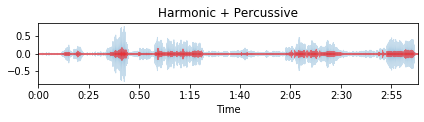

In [7]:
ym, srm = librosa.load('Mozart - Lacrimosa.mp3')

ym, index = librosa.effects.trim(ym)

y_harmm, y_percm = librosa.effects.hpss(ym)
plt.subplot(3, 1, 3)
waveplot(y_harmm, sr=srm, alpha=0.25)
waveplot(y_percm, sr=srm, color='r', alpha=0.5)
plt.title('Harmonic + Percussive')
plt.tight_layout()
plt.show()

### Recurrence Plot - MFCC (Mozart Lacrimosa)

/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:


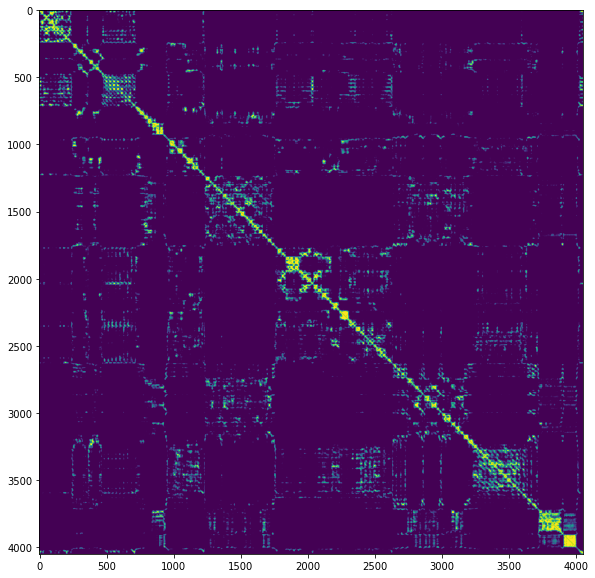

In [8]:
hop_length = 1024
mfcc = librosa.feature.mfcc(y=ym, sr=srm, hop_length=hop_length)
R = librosa.segment.recurrence_matrix(mfcc)

plt.figure(figsize = (10,10))
plt.imshow(R, interpolation='bilinear')

In [5]:
import IPython.display as ipd
ipd.Audio('Mozart - Lacrimosa.mp3') # load a local WAV file

### Bella Bartok Adagio for Strings

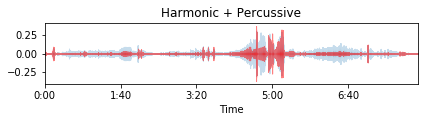

In [15]:


import matplotlib.pyplot as plt

yb, srb = librosa.load('Bartok Sz. 106 - 3. Adagio.mp3')
yb, index = librosa.effects.trim(yb)


y_harmb, y_percb = librosa.effects.hpss(yb)
plt.subplot(3, 1, 3)
waveplot(y_harmb, sr=srb, alpha=0.25)
waveplot(y_percb, sr=srb, color='r', alpha=0.5)
plt.title('Harmonic + Percussive')
plt.tight_layout()
plt.show()

/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:


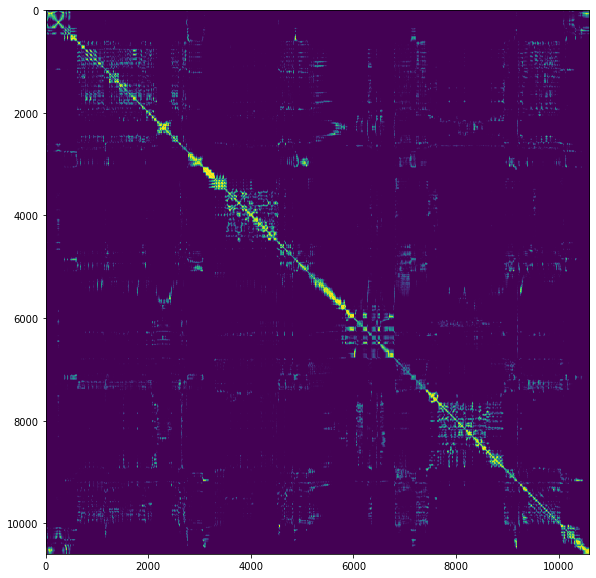

In [17]:
hop_length = 1024
mfcc = librosa.feature.mfcc(y=yb, sr=srb, hop_length=hop_length)
R = librosa.segment.recurrence_matrix(mfcc)

plt.figure(figsize = (10,10))
plt.imshow(R, interpolation='bilinear')

### Vivaldi - Spring

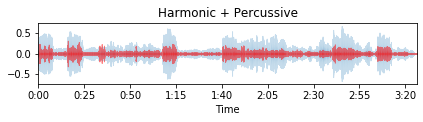

In [23]:
import matplotlib.pyplot as plt

ysp, srsp = librosa.load('Spring. Antonio Vivaldi.mp3')

ysp, index = librosa.effects.trim(ysp)


y_harmsp, y_percsp = librosa.effects.hpss(ysp)
plt.subplot(3, 1, 3)
waveplot(y_harmsp, sr=srsp, alpha=0.25)
waveplot(y_percsp, sr=srsp, color='r', alpha=0.5)
plt.title('Harmonic + Percussive')
plt.tight_layout()
plt.show()

/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:


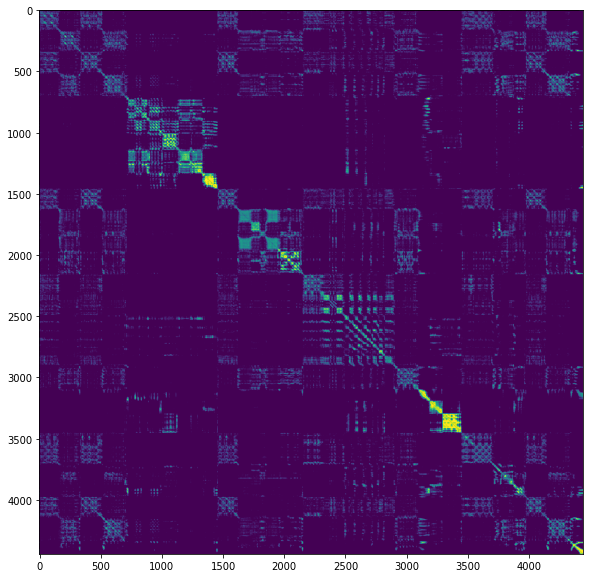

In [24]:
hop_length = 1024
mfcc = librosa.feature.mfcc(y=ysp, sr=srsp, hop_length=hop_length)
R = librosa.segment.recurrence_matrix(mfcc)

plt.figure(figsize = (10,10))
plt.imshow(R, interpolation='bilinear')

### 古琴Guqin流水Flowing Water

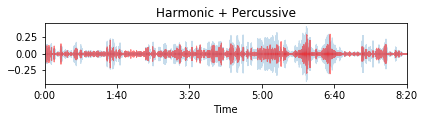

In [5]:
import matplotlib.pyplot as plt

ysg, srg = librosa.load('古琴Guqin流水Flowing Water.mp3')

ysg, index = librosa.effects.trim(ysg)


y_harmg, y_percg = librosa.effects.hpss(ysg)
plt.subplot(3, 1, 3)
waveplot(y_harmg, sr=srg, alpha=0.25)
waveplot(y_percg, sr=srg, color='r', alpha=0.5)
plt.title('Harmonic + Percussive')
plt.tight_layout()
plt.show()

/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/home/spenser/.conda/envs/gpu/lib/python3.7/site-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:


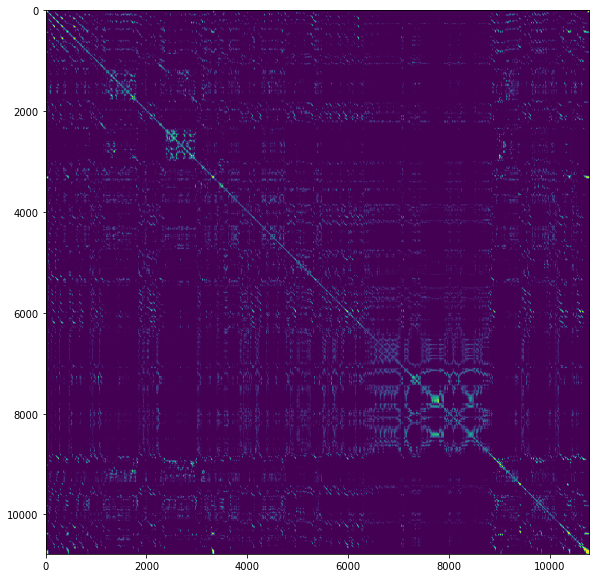

In [6]:
hop_length = 1024
mfcc = librosa.feature.mfcc(y=ysg, sr=srg, hop_length=hop_length)
R = librosa.segment.recurrence_matrix(mfcc)

plt.figure(figsize = (10,10))
plt.imshow(R, interpolation='bilinear')

In [10]:

ipd.Audio('古琴Guqin流水Flowing Water.mp3') # load a local WAV file